#Object Detection API implementation
using Tensorflow v2 Object Detection API

## Environment Setup

### Install required libraries

In [ ]:
%tensorflow_version

!pip install -q pillow lxml jupyter matplotlib cython pandas contextlib2
!apt-get install -qq protobuf-compiler
!pip install -q pycocotools tf_slim

Currently selected TF version: 2.x
Available versions:
* 1.x
* 2.x
     |████████████████████████████████| 358kB 5.4MB/s 


### Set configurations

In [ ]:
import os

# Repo URL
repo_url = 'https://github.com/freAK14/Object_Detection_API'

# Models
MODELS_CONFIG = {
    'faster_rcnn_inception_resnet_v2': {
        'model_name': 'faster_rcnn_inception_resnet_v2_1024x1024_coco17_tpu-8',
        'model_path': '/models/tf2/faster_rcnn_inception_resnet_v2_1024x1024_coco17_tpu-8/',
        'pipeline_file': 'pipeline.config'
    },
    'ssd_resnet152_v1_fpn': {
        'model_name': 'ssd_resnet152_v1_fpn_1024x1024_coco17_tpu-8',
        'model_path': '/models/tf2/ssd_resnet152_v1_fpn_1024x1024_coco17_tpu-8/',
        'pipeline_file': 'pipeline.config'
    },
    'ssd_mobilenet_v2_fpnlite': {
        'model_name': 'ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8',
        'model_path': '/models/tf2/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8/',
        'pipeline_file': 'pipeline.config'
    },
    'ssd_resnet50_v1_fpn': {
        'model_name': 'ssd_resnet50_v1_fpn_640x640_coco17_tpu-8',
        'model_path': '/models/tf2/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/',
        'pipeline_file': 'pipeline.config'
    },
    'efficientdet_d2_coco17': {
        'model_name': 'efficientdet_d2_coco17_tpu-32',
        'model_path': '/models/tf2/efficientdet_d2_coco17_tpu-32/',
        'pipeline_file' : 'pipeline.config'
    }
}

# Select a model to use.
selected_model = 'efficientdet_d2_coco17'

model_name = MODELS_CONFIG[selected_model]['model_name']
model_path = MODELS_CONFIG[selected_model]['model_path']
pipeline_file = MODELS_CONFIG[selected_model]['pipeline_file']

# Set Repository Home Directory
repo_dir_path = os.path.abspath(os.path.join('.', os.path.basename(repo_url)))

# Set Label Map (.pbtxt) path and pipeline.config path
label_map_pbtxt_fname = repo_dir_path + '/annotations/label_map.pbtxt'
pipeline_fname = repo_dir_path + model_path + pipeline_file

# Set .record path
test_record_fname = repo_dir_path + '/annotations/test.record'
train_record_fname = repo_dir_path + '/annotations/train.record'

# Set output directories and clean up
model_dir = repo_dir_path + '/training/'
output_dir = repo_dir_path + '/exported-models/'

!rm -rf {model_dir} {output_dir}
os.makedirs(model_dir, exist_ok=True)
os.makedirs(output_dir, exist_ok=True)

### Clone Tensorflow models

In [ ]:
# Clone Tensorflow model repo
%cd /content
!git clone --quiet https://github.com/tensorflow/models.git
# Compile protocol buffers
%cd /content/models/research
!protoc object_detection/protos/*.proto --python_out=.
# Set environment variables
import os
os.environ['PYTHONPATH'] += ':/content/models:/content/models/research/:/content/models/research/slim/'
%cd /content/models/research/slim/
# Install libraries
!pip install .
%cd /content/models/research/
# Test
!python object_detection/builders/model_builder_test.py


/content
/content/models/research
/content/models/research/slim
Processing /content/models/research/slim
  Created wheel for slim: filename=slim-0.1-cp37-none-any.whl size=231267 sha256=04bf41f41ad18ffd6ccf551f4b59db4dcb2cc9e738cf87ddeaedb5ac50f0eefe
  Stored in directory: /tmp/pip-ephem-wheel-cache-k8ll82ha/wheels/c0/cb/18/e76d02033e40846187fac06f0f855c6434d52aadf580451f20
Successfully built slim
/content/models/research
2021-05-02 16:26:28.697552: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0


### COCO API Installation

In [ ]:
# Coco Installation (Optional, required when using Coco Evaluation)
%cd /content
!git clone --quiet https://github.com/cocodataset/cocoapi.git
%cd cocoapi/PythonAPI
!make
!cp -r pycocotools /content/models/research/

/content
/content/cocoapi/PythonAPI
python setup.py build_ext --inplace
running build_ext
cythoning pycocotools/_mask.pyx to pycocotools/_mask.c
/usr/local/lib/python3.7/dist-packages/Cython/Compiler/Main.py:369: FutureWarning: Cython directive 'language_level' not set, using 2 for now (Py2). This will change in a later release! File: /content/cocoapi/PythonAPI/pycocotools/_mask.pyx
  tree = Parsing.p_module(s, pxd, full_module_name)
building 'pycocotools._mask' extension
creating build
creating build/common
creating build/temp.linux-x86_64-3.7
creating build/temp.linux-x86_64-3.7/pycocotools
x86_64-linux-gnu-gcc -pthread -Wno-unused-result -Wsign-compare -DNDEBUG -g -fwrapv -O2 -Wall -g -fdebug-prefix-map=/build/python3.7-a56wZI/python3.7-3.7.10=. -fstack-protector-strong -Wformat -Werror=format-security -g -fdebug-prefix-map=/build/python3.7-a56wZI/python3.7-3.7.10=. -fstack-protector-strong -Wformat -Werror=format-security -Wdate-time -D_FORTIFY_SOURCE=2 -fPIC -I/usr/local/lib/pytho

### Download Pretrained Model

In [ ]:
%cd /content/models/research

import os
import shutil
import glob
import urllib.request
import tarfile
MODEL_FILE = model_name + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/'
DEST_DIR = '/content/models/research/pretrained_model'

if not (os.path.exists(MODEL_FILE)):
    urllib.request.urlretrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)

tar = tarfile.open(MODEL_FILE)
tar.extractall()
tar.close()

os.remove(MODEL_FILE)
if (os.path.exists(DEST_DIR)):
    shutil.rmtree(DEST_DIR)
os.rename(model_name, DEST_DIR)

# Check downloaded files
!echo {DEST_DIR}
!ls -alh {DEST_DIR}

# Set fine tune checkpoint
fine_tune_checkpoint = os.path.join(DEST_DIR, "checkpoint/ckpt-0")
print("fine_tune_checkpoint: ", fine_tune_checkpoint)


/content/models/research
/content/models/research/pretrained_model
total 24K
drwxr-x---  4 345018 89939 4.0K Jul 11  2020 .
drwxr-xr-x 24 root   root  4.0K May  2 16:26 ..
drwxr-x---  2 345018 89939 4.0K Jul 10  2020 checkpoint
-rw-r-----  1 345018 89939 4.5K Jul 11  2020 pipeline.config
drwxr-x---  4 345018 89939 4.0K Jul 10  2020 saved_model
fine_tune_checkpoint:  /content/models/research/pretrained_model/checkpoint/ckpt-0


### Clone the project repository

In [ ]:
import os
%cd /content
# Clean up
!rm -rf {repo_dir_path}

# Clone
!git clone {repo_url}

# Pull (just in case the repo already exists)
%cd {repo_dir_path}
!git pull

# Check if label map and pipeline files exist
assert os.path.isfile(label_map_pbtxt_fname), '`{}` not exist'.format(label_map_pbtxt_fname)
assert os.path.isfile(pipeline_fname), '`{}` not exist'.format(pipeline_fname)

/content
Cloning into 'Object_Detection_API'...
remote: Enumerating objects: 120, done.
remote: Counting objects: 100% (51/51), done.
remote: Compressing objects: 100% (32/32), done.
remote: Total 120 (delta 10), reused 47 (delta 7), pack-reused 69
Receiving objects: 100% (120/120), 88.39 MiB | 24.71 MiB/s, done.
Resolving deltas: 100% (24/24), done.
/content/Object_Detection_API
Already up to date.


In [ ]:
# Check pipeline config - update if required
!cat {pipeline_fname}

model {
  ssd {
    num_classes: 1
    image_resizer {
      keep_aspect_ratio_resizer {
        min_dimension: 768
        max_dimension: 768
        pad_to_max_dimension: true
      }
    }
    feature_extractor {
      type: "ssd_efficientnet-b2_bifpn_keras"
      conv_hyperparams {
        regularizer {
          l2_regularizer {
            weight: 3.9999998989515007e-05
          }
        }
        initializer {
          truncated_normal_initializer {
            mean: 0.0
            stddev: 0.029999999329447746
          }
        }
        activation: SWISH
        batch_norm {
          decay: 0.9900000095367432
          scale: true
          epsilon: 0.0010000000474974513
        }
        force_use_bias: true
      }
      bifpn {
        min_level: 3
        max_level: 7
        num_iterations: 5
        num_filters: 112
      }
    }
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 1.0
        x_scale: 1.0
        height_scale: 1.0
        width_scale: 1.

## Preprocess Images
This part can be skipped if image labels have already been converted to TFRecord files.

Assuming all images are under images/ directory with the labels in .xml files, generated by labelImg in format.

### Split to train set and test set

In [ ]:
%cd {repo_dir_path}

# Split images to train:test = 9:1
!python scripts/partition_dataset.py -x -i images/ -r 0.1

# Check test images
!ls images/test

/content/driving-object-detection
 green_211.png			      red_454.png
 green_211.xml			      red_454.xml
 green_51.jpg			      red_623.png
 green_51.xml			      red_623.xml
 green_63.jpg			      red_656.png
 green_63.xml			      red_656.xml
'image_2020-09-01 12:52:20.106.jpg'   red_775.png
'image_2020-09-01 12:52:20.106.xml'   red_775.xml
'image_2020-09-01 12:52:20.504.jpg'   yellow_858.jpg
'image_2020-09-01 12:52:20.504.xml'   yellow_858.xml
'image_2020-09-01 12:54:56.081.jpg'   yellow_860.jpg
'image_2020-09-01 12:54:56.081.xml'   yellow_860.xml
 red_376.png			      yellow_912.jpg
 red_376.xml			      yellow_912.xml
 red_451.jpg			      yellow_975.png
 red_451.xml			      yellow_975.xml


### Convert .xml files to csv

In [ ]:
# Create train data:
!python scripts/xml_to_csv.py -i images/train -o annotations/train_labels.csv

# Create test data:
!python scripts/xml_to_csv.py -i images/test -o annotations/test_labels.csv

Successfully converted xml to csv.
Successfully converted xml to csv.


### Convert to TFRecord format (.record)

In [ ]:
# Create train data:
!python scripts/generate_tfrecord.py -c annotations/train_labels.csv -i images/train -x images/train -o annotations/train.record -l annotations/label_map.pbtxt

# Create test data:
!python scripts/generate_tfrecord.py -c annotations/test_labels.csv -i images/test -x images/test -o annotations/test.record -l annotations/label_map.pbtxt

# Check
assert os.path.isfile(test_record_fname), '`{}` not exist'.format(test_record_fname)
assert os.path.isfile(train_record_fname), '`{}` not exist'.format(train_record_fname)

Successfully created the TFRecord file: annotations/train.record
Successfully created the CSV file: annotations/train_labels.csv
Successfully created the TFRecord file: annotations/test.record
Successfully created the CSV file: annotations/test_labels.csv


## Training

### Tensorboard

In [ ]:
# Set log directory for tensorboard to watch
LOG_DIR = model_dir

# Clean up the directory
!rm -rf {LOG_DIR}/*

In [ ]:
# Use magic command to launch tensorboard within the notebook
%load_ext tensorboard
%tensorboard --logdir {LOG_DIR}

<IPython.core.display.Javascript object>

### Train!

In [ ]:
# Make sure to have the latest project repo downloaded
%cd {repo_dir_path}
!git pull

/content/Object_Detection_API
Already up to date.


In [ ]:
!pip install lvis
!pip install tensorflow-addons

     |████████████████████████████████| 706kB 4.2MB/s 


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd {repo_dir_path}
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_fname} \
    --model_dir={model_dir} \
    --alsologtostderr

/content/Object_Detection_API
2021-05-02 17:44:52.208679: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-05-02 17:44:55.241785: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-05-02 17:44:55.242814: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-05-02 17:44:55.271656: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-05-02 17:44:55.272435: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla K80 computeCapability: 3.7
coreClock: 0.8235GHz coreCount: 13 deviceMemorySize: 11.17GiB deviceMemoryBandwidth: 223.96GiB/s
2021-05-02 17:44:55.272480: I tensorflow/stream_ex

In [ ]:
# Check the generated files
!ls -lrt {model_dir}

total 142080
drwxr-xr-x 2 root root     4096 Apr 27 16:07 train
-rw-r--r-- 1 root root 20730756 Apr 27 16:21 ckpt-2.data-00000-of-00001
-rw-r--r-- 1 root root    47999 Apr 27 16:21 ckpt-2.index
-rw-r--r-- 1 root root 20730756 Apr 27 16:35 ckpt-3.data-00000-of-00001
-rw-r--r-- 1 root root    47999 Apr 27 16:35 ckpt-3.index
-rw-r--r-- 1 root root 20730756 Apr 27 16:48 ckpt-4.data-00000-of-00001
-rw-r--r-- 1 root root    47999 Apr 27 16:48 ckpt-4.index
-rw-r--r-- 1 root root 20730756 Apr 27 17:02 ckpt-5.data-00000-of-00001
-rw-r--r-- 1 root root    47999 Apr 27 17:02 ckpt-5.index
-rw-r--r-- 1 root root 20730756 Apr 27 17:15 ckpt-6.data-00000-of-00001
-rw-r--r-- 1 root root    47999 Apr 27 17:15 ckpt-6.index
-rw-r--r-- 1 root root 20730756 Apr 27 17:29 ckpt-7.data-00000-of-00001
-rw-r--r-- 1 root root    47999 Apr 27 17:29 ckpt-7.index
-rw-r--r-- 1 root root 20730756 Apr 27 17:42 ckpt-8.data-00000-of-00001
-rw-r--r-- 1 root root    47999 Apr 27 17:42 ckpt-8.index
-rw-r--r-- 1 root root    

### Evaluation (Optional)

In [ ]:
%cd {repo_dir_path}
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_fname} \
    --model_dir={model_dir} \
    --checkpoint_dir={model_dir} \
    --eval_timeout=60

/content/Object_Detection_API
2021-05-02 18:57:52.213314: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
W0502 18:57:55.188872 139792763561856 model_lib_v2.py:1060] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0502 18:57:55.189160 139792763561856 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0502 18:57:55.189312 139792763561856 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0502 18:57:55.189473 139792763561856 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0502 18:57:55.189651 139792763561856 model_lib_v2.py:1081] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2021-05-02 18:57:55.198607:

In [ ]:
# Check the generated files
!ls -lrt {model_dir}

total 111732
drwxr-xr-x 2 root root     4096 Apr  9 13:00 train
-rw-r--r-- 1 root root 10457059 Apr  9 13:01 ckpt-1.data-00000-of-00001
-rw-r--r-- 1 root root    26244 Apr  9 13:01 ckpt-1.index
-rw-r--r-- 1 root root 20730756 Apr  9 13:15 ckpt-2.data-00000-of-00001
-rw-r--r-- 1 root root    47999 Apr  9 13:15 ckpt-2.index
-rw-r--r-- 1 root root 20730756 Apr  9 13:28 ckpt-3.data-00000-of-00001
-rw-r--r-- 1 root root    47999 Apr  9 13:28 ckpt-3.index
-rw-r--r-- 1 root root 20730756 Apr  9 13:42 ckpt-4.data-00000-of-00001
-rw-r--r-- 1 root root    47999 Apr  9 13:42 ckpt-4.index
-rw-r--r-- 1 root root 20730756 Apr  9 13:56 ckpt-5.data-00000-of-00001
-rw-r--r-- 1 root root    47999 Apr  9 13:56 ckpt-5.index
-rw-r--r-- 1 root root 20730756 Apr  9 14:09 ckpt-6.data-00000-of-00001
-rw-r--r-- 1 root root    47999 Apr  9 14:09 ckpt-6.index
-rw-r--r-- 1 root root      610 Apr  9 14:09 checkpoint
drwxr-xr-x 2 root root     4096 Apr  9 14:30 eval


## Export the output model

In [ ]:
%cd {repo_dir_path}
!python /content/models/research/object_detection/exporter_main_v2.py \
    --input_type image_tensor \
    --pipeline_config_path {pipeline_fname} \
    --trained_checkpoint_dir {model_dir} \
    --output_directory {output_dir}

/content/Object_Detection_API
2021-05-02 18:30:26.939672: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-05-02 18:30:29.546462: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-05-02 18:30:29.547484: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-05-02 18:30:29.574351: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-05-02 18:30:29.575033: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla K80 computeCapability: 3.7
coreClock: 0.8235GHz coreCount: 13 deviceMemorySize: 11.17GiB deviceMemoryBandwidth: 223.96GiB/s
2021-05-02 18:30:29.575100: I tensorflow/stream_ex

In [ ]:
# Check the output files
!echo {output_dir}
!ls -lsr {output_dir}

/content/Object_Detection_API/exported-models/
total 16
4 drwxr-xr-x 4 root root 4096 May  2 18:33 saved_model
8 -rw-r--r-- 1 root root 4395 May  2 18:33 pipeline.config
4 drwxr-xr-x 2 root root 4096 May  2 18:30 checkpoint


### Archive the output directory

In [ ]:
%cd {repo_dir_path}
!tar zcvf trained_model.tar.gz {output_dir}

/content/Object_Detection_API
tar: Removing leading `/' from member names
/content/Object_Detection_API/exported-models/
/content/Object_Detection_API/exported-models/checkpoint/
/content/Object_Detection_API/exported-models/checkpoint/checkpoint
/content/Object_Detection_API/exported-models/checkpoint/ckpt-0.data-00000-of-00001
/content/Object_Detection_API/exported-models/checkpoint/ckpt-0.index
/content/Object_Detection_API/exported-models/saved_model/
/content/Object_Detection_API/exported-models/saved_model/saved_model.pb
/content/Object_Detection_API/exported-models/saved_model/assets/
/content/Object_Detection_API/exported-models/saved_model/variables/
/content/Object_Detection_API/exported-models/saved_model/variables/variables.data-00000-of-00001
/content/Object_Detection_API/exported-models/saved_model/variables/variables.index
/content/Object_Detection_API/exported-models/pipeline.config


### Copy to Drive

In [ ]:
#%cd /content/Object_Detection_API
!cp trained_model.tar.gz "/content/drive/MyDrive/count"

cp: cannot stat 'efficientdet_model.tar.gz': No such file or directory


### Download the archive

In [ ]:
from google.colab import files
files.download('trained_model.tar.gz')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

---

## Prediction using the trained model

### Set images for the inference

In [ ]:
import os

# Use images in test dir (update this if you have other images for inference)
IMAGE_DIR = os.path.join(repo_dir_path, "images")
IMAGE_PATHS = []

for file in os.listdir(IMAGE_DIR):
    if file.endswith(".jpg") or file.endswith(".png"):
        IMAGE_PATHS.append(os.path.join(IMAGE_DIR, file))

IMAGE_PATHS

['/content/Object_Detection_API/images/boxx9.jpg',
 '/content/Object_Detection_API/images/boxx3.jpg',
 '/content/Object_Detection_API/images/boxx5.jpg',
 '/content/Object_Detection_API/images/boxx1.jpg',
 '/content/Object_Detection_API/images/boxx8.jpg',
 '/content/Object_Detection_API/images/boxx4.jpg',
 '/content/Object_Detection_API/images/boxx6.jpg',
 '/content/Object_Detection_API/images/newtest.jpg',
 '/content/Object_Detection_API/images/boxx7.jpg',
 '/content/Object_Detection_API/images/boxx10.jpg',
 '/content/Object_Detection_API/images/boxx2.jpg']

### Load the trained model

In [ ]:
%cd /content/models/research/

import time
import tensorflow as tf # Added as colab instance often crash
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

# Label Map path
PATH_TO_LABELS = label_map_pbtxt_fname
# Saved model path
PATH_TO_SAVED_MODEL = os.path.join(output_dir, "saved_model")

print('Loading model...', end='')
start_time = time.time()

# Load saved model and build the detection function
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)

end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# Set category index
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)

/content/models/research
Loading model...

Done! Took 51.27400803565979 seconds


### Make prediction!

Running inference for /content/Object_Detection_API/images/boxx9.jpg... Done
Running inference for /content/Object_Detection_API/images/boxx3.jpg... Done
Running inference for /content/Object_Detection_API/images/boxx5.jpg... Done
Running inference for /content/Object_Detection_API/images/boxx1.jpg... Done
Running inference for /content/Object_Detection_API/images/boxx8.jpg... Done
Running inference for /content/Object_Detection_API/images/boxx4.jpg... Done
Running inference for /content/Object_Detection_API/images/boxx6.jpg... Done
Running inference for /content/Object_Detection_API/images/newtest.jpg... Done
Running inference for /content/Object_Detection_API/images/boxx7.jpg... Done
Running inference for /content/Object_Detection_API/images/boxx10.jpg... Done
Running inference for /content/Object_Detection_API/images/boxx2.jpg... Done


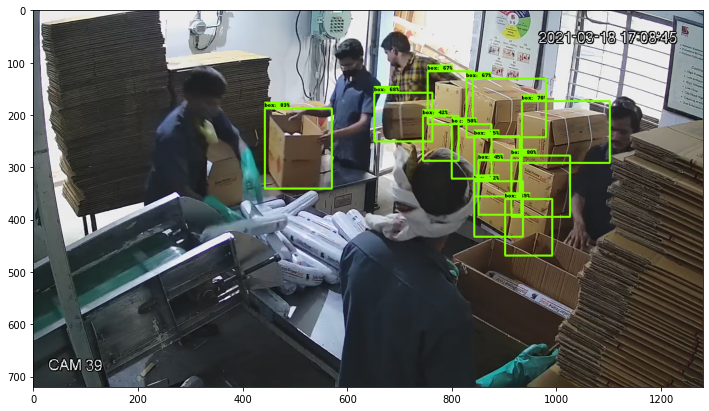

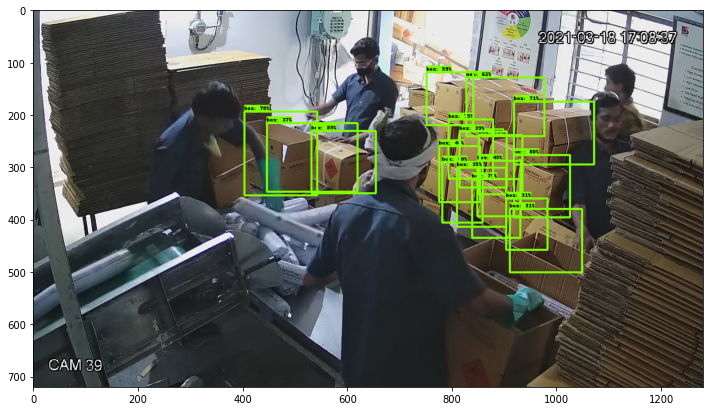

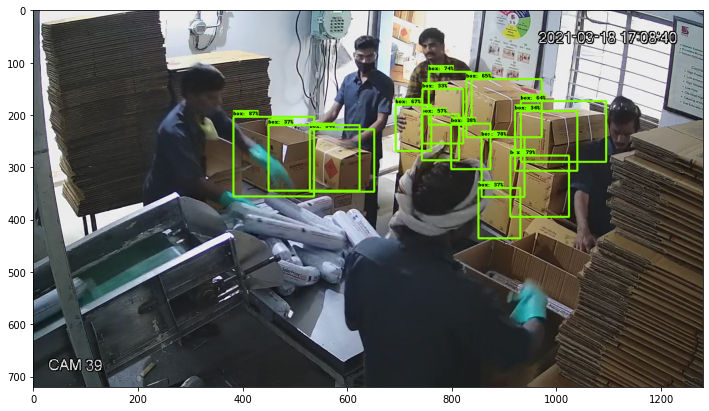

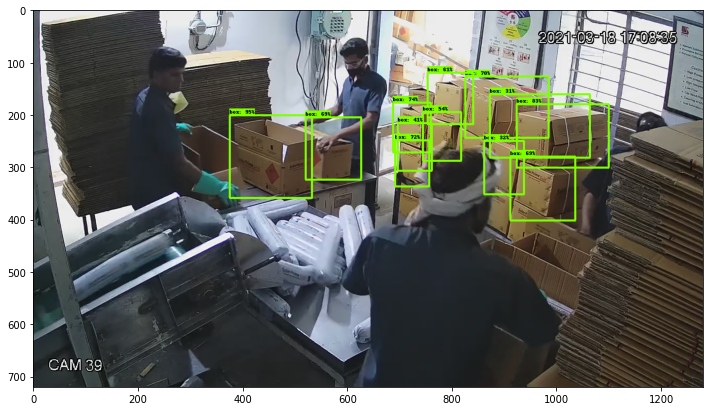

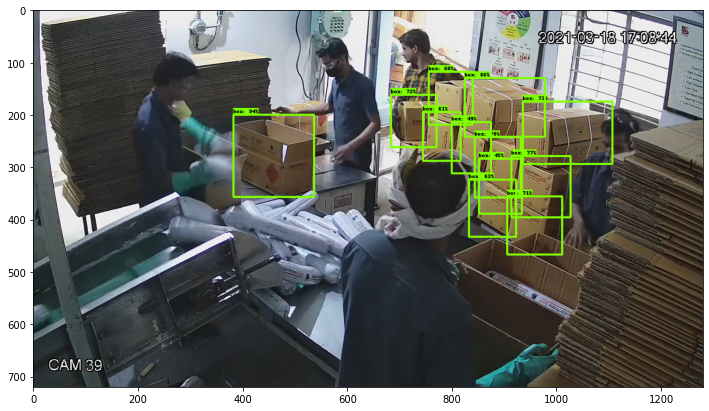

...

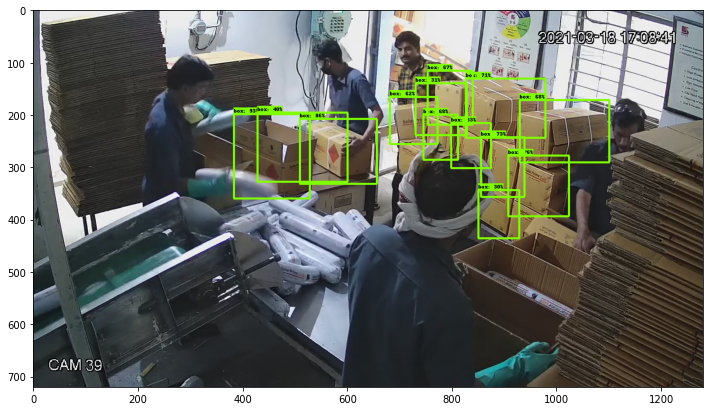

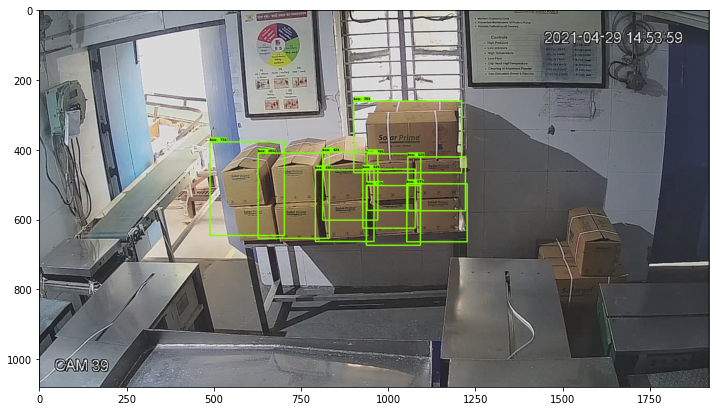

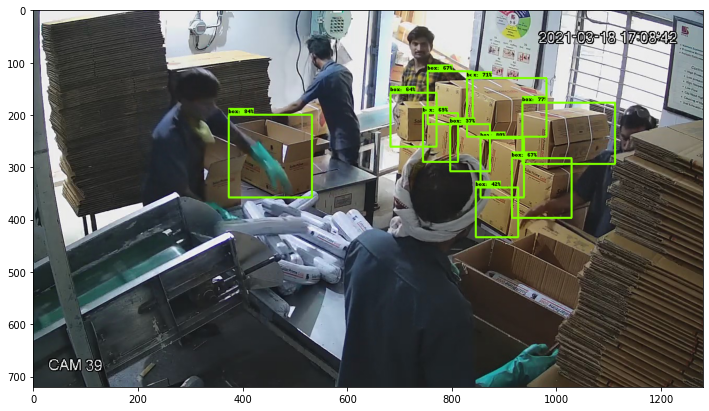

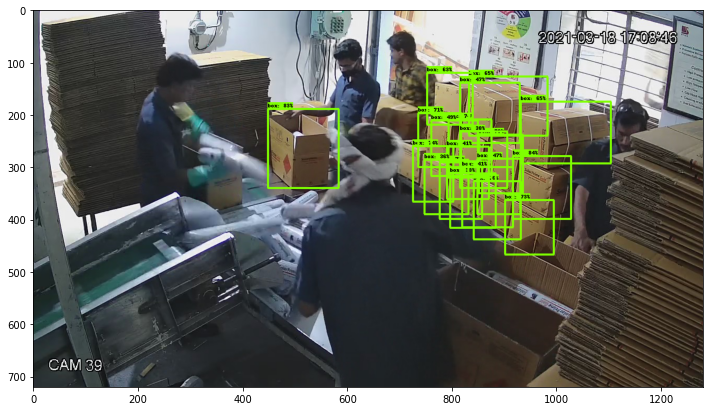

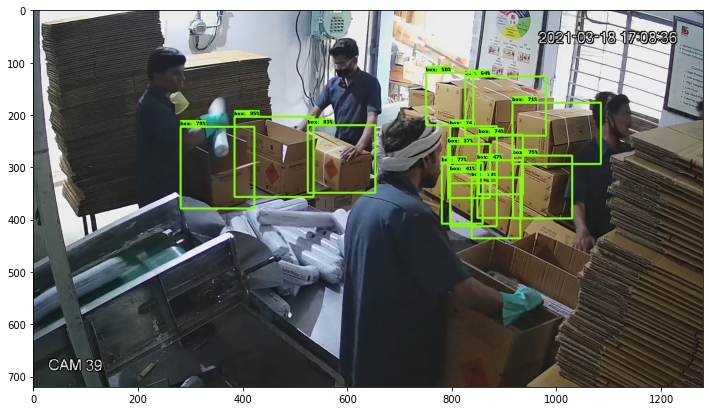

In [ ]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')   # Suppress Matplotlib warnings
# This is required to display the images.
%matplotlib inline 

for image_path in IMAGE_PATHS:

    print('Running inference for {}... '.format(image_path), end='')

    # Puts image into numpy array to feed into tensorflow graph.
    # Note that by convention we put it into a numpy array with shape
    #   (height, width, channels), where channels=3 for RGB.
    image_np = np.array(Image.open(image_path))

    # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
    input_tensor = tf.convert_to_tensor(image_np)

    # The model expects a batch of images, so add an axis with `tf.newaxis`.
    input_tensor = input_tensor[tf.newaxis, ...]

    # input_tensor = np.expand_dims(image_np, 0)
    detections = detect_fn(input_tensor)

    # All outputs are batches tensors.
    # Convert to numpy arrays, and take index [0] to remove the batch dimension.
    # We're only interested in the first num_detections.
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy()
                   for key, value in detections.items()}
    detections['num_detections'] = num_detections

    # detection_classes should be ints.
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

    image_np_with_detections = image_np.copy()

    viz_utils.visualize_boxes_and_labels_on_image_array(
          image_np_with_detections,
          detections['detection_boxes'],
          detections['detection_classes'],
          detections['detection_scores'],
          category_index,
          use_normalized_coordinates=True,
          max_boxes_to_draw=20,
          min_score_thresh=.30,
          agnostic_mode=False)

    plt.figure(figsize = (12,8))
    plt.imshow(image_np_with_detections)
    print('Done')
plt.show()

In [ ]:
while True:pass

KeyboardInterrupt: ignored